# Sanity check: re-discovering known goal states of simple models

For some simple models we know the true goal states as these can be computed analytically.

In this notebook we verify that our IMGEP pipeline can indeed recover those true goal states.

In [1]:
nb_save_figs = False

## Imports and Utils

In [2]:
# %pip install -q addict
# %pip install sbmltoodejax==0.4.3
# %pip install -q autodiscjax
# %pip install -q plotly

In [3]:
import jax
jax.config.update("jax_platform_name", "cpu")
import jax.numpy as jnp
import jax.random as jrandom
import jax.tree_util as jtu
from jax import jit, vmap

from addict import Dict
from autodiscjax import DictTree
from autodiscjax.experiment_pipelines import run_imgep_experiment
import autodiscjax.modules.grnwrappers as grn
import autodiscjax.modules.imgepwrappers as imgep
from autodiscjax.modules.optimizers import EAOptimizer
from autodiscjax.utils.create_modules import *
from autodiscjax.utils.misc import uniform, normal

import matplotlib.colors as mcolors
import plotly
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sbmltoodejax.utils import load_biomodel

In [4]:
seed = 0
key = jrandom.PRNGKey(seed)

In [5]:
#@title [Plot utils]

# when need to display only a subset of points in trajectory scatters (otherwise html very big)
def downsample_traj(traj, scaling_vector=jnp.ones((2,)), eps=0.05):
    """
    traj: (2, T) array
    scaling_vector: 2D array
    eps: we discard all points that are closer to eps
    """

    scaling_vector = scaling_vector[:, jnp.newaxis]
    traj = traj/scaling_vector
    traj_filt  = [traj[:, i] for i in range(10)]
    ids_filt = [i for i in range(10)]
    
    eps_max = 2
    
    
    for i, e in enumerate(traj.T):
        if i>=10 and (jnp.linalg.norm(e-traj_filt[-1], ord=2) > eps or i>len(traj.T)-10):
            traj_filt.append(e)
            ids_filt.append(i)
    traj_filt = jnp.array(traj_filt).T
    ids_filt = jnp.array(ids_filt)
    return traj_filt*scaling_vector, ids_filt

# color to visualize time from trajectory start point A (red) to trajectory end point B (cyan) 
n_points = 100 
c = [mcolors.hsv_to_rgb((step / (2*n_points), 1, 1)) for step in range(n_points)]
traj_cscale=[(x.item(), f'rgb({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)})') for (x, color) in zip(jnp.linspace(0., 1., len(c)), c)]

# default colors
default_colors = ['rgb(204,121,167)', 
                  'rgb(0,114,178)',
                  'rgb(230,159,0)',  
                  'rgb(0,158,115)',
                  'rgb(127,127,127)',
                  'rgb(240,228,66)',
                  'rgb(148,103,189)',
                  'rgb(86,180,233)',
                  'rgb(213,94,0)',
                  'rgb(140,86,75)',
                  'rgb(214,39,40)',
                  'rgb(0,0,0)']
transparency = 0.6
default_colors_shade = ['rgba' + color[3:-1]  + ', ' + str(transparency) + ')' for color in default_colors]

default_dashes = ['solid', 'longdash', 'dot', 'dash', 'dashdot', 'longdashdot',
                 'solid', 'longdash', 'dot', 'dash', 'dashdot', 'longdashdot']


# plotly default layout
default_layout = Dict(
    width = 600,
    height = 450,
    font=Dict(
        size=10,
    ),
    title=Dict(font_size=10),
    
    xaxis=Dict(
        titlefont=Dict(size=10),
        tickfont=Dict(size=10),
        title_standoff=5,
        linecolor='rgba(0, 0, 0, .1)',
    ),
    
    yaxis=Dict(
        titlefont=Dict(size=10),
        tickfont=Dict(size=10),
        title_standoff=5,
        gridcolor='rgba(0, 0, 0, .1)',
        linecolor='rgba(0, 0, 0, .1)',
        #zerolinecolor='rgba(0, 0, 0, .1)'
    ),
    
    updatemenus=[],
    autosize=True,

    plot_bgcolor='rgba(0, 0, 0, 0)', 
    paper_bgcolor='rgba(0, 0, 0, 0)', 

    margin = Dict(
        l=20,
        r=20,
        b=20,
        t=20
        ),

    legend=Dict(
        xanchor='left',
        yanchor='top',
        y=1,
        x=1,
        font_size=10,
     ),     

    )

default_annotation_layout = Dict(
    font_size=10,
)

## IMGEP Experiment Utils

The below codebase is used to run the imgep experiment and taken from the paper's github repository: [https://github.com/flowersteam/curious-exploration-of-grn-competencies/](https://github.com/flowersteam/curious-exploration-of-grn-competencies/)

In [6]:
# exploration hyperparameters
N = 200 # number of simulations (initial conditions)
n_random_batches = int(2)
n_imgep_batches = int(8)
batch_size = int(N / (n_random_batches+n_imgep_batches))
T = 20 # number of seconds per simulation
sigma = 0.1 # magnitude of mutations
ymin=jnp.array([0.,0.,0.])
ymax=jnp.array([5.,1.,5.])

In [7]:
class ExperimentConfig:

    def __init__(self, model_name, model_filepath, observed_node_ids, ymin, ymax, T, n_nodes):
        self.model_name = model_name
        self.model_filepath = f"data/{model_filepath}"
        self.observed_node_ids = observed_node_ids
        self.ymin = ymin
        self.ymax = ymax
        self.T = T
        self.n_nodes = n_nodes

    def get_pipeline_config(self):
        config = Dict()
        config.jax_platform_name = "cpu"
        config.seed = int(0)
        config.n_random_batches = n_random_batches
        config.n_imgep_batches = n_imgep_batches
        config.batch_size = batch_size
        assert len(self.observed_node_ids) == 2
        config.experiment_data_save_folder = f"data/{self.model_name}/nodes_{self.observed_node_ids[0]}_{self.observed_node_ids[1]}/experiment_data/"
        return config

    def get_system_rollout_config(self):
        config = Dict()
        config.system_type = "grn"
        config.model_filepath = self.model_filepath
        config.atol = 1e-6
        config.rtol = 1e-12
        config.mxstep = 1000
        config.deltaT = 0.1
        config.n_system_steps = int(self.T/config.deltaT)
        return config

    def get_rollout_statistics_encoder_config(self):
        config = Dict()
        config.statistics_type = "null"
        return config

    def get_random_intervention_generator_config(self):
        config = Dict()
        config.intervention_type = "set_uniform"
        system_rollout_config = self.get_system_rollout_config()
        config.controlled_intervals = [[-system_rollout_config.deltaT/2.0, system_rollout_config.deltaT/2.0]]

        config.controlled_node_ids = list(range(self.n_nodes))
        intervention_params_tree = DictTree()
        for y_idx in config.controlled_node_ids:
            intervention_params_tree.y[y_idx] = "placeholder"

        config.out_treedef = jtu.tree_structure(intervention_params_tree)
        config.out_shape = jtu.tree_map(lambda _: (len(config.controlled_intervals),),
                                        intervention_params_tree)
        config.out_dtype = jtu.tree_map(lambda _: jnp.float32, intervention_params_tree)

        config.low = DictTree()
        config.high = DictTree()
        for y_idx in config.controlled_node_ids:
            config.low.y[y_idx] = self.ymin[y_idx] * jnp.ones(shape=config.out_shape.y[y_idx],
                                                              dtype=config.out_dtype.y[y_idx])
            config.high.y[y_idx] = self.ymax[y_idx] * jnp.ones(shape=config.out_shape.y[y_idx],
                                                               dtype=config.out_dtype.y[y_idx])

        return config

    def get_perturbation_generator_config(self):
        config = Dict()
        config.perturbation_type = "null"
        return config

    def get_goal_embedding_encoder_config(self):
        config = Dict()
        config.encoder_type = "filter"
        goal_embedding_tree = "placeholder"
        config.out_treedef = jtu.tree_structure(goal_embedding_tree)
        config.out_shape = jtu.tree_map(lambda _: (len(self.observed_node_ids),), goal_embedding_tree)
        config.out_dtype = jtu.tree_map(lambda _: jnp.float32, goal_embedding_tree)
        config.filter_fn = jtu.Partial(lambda system_outputs: system_outputs.ys[..., self.observed_node_ids, -1])

        return config

    def get_goal_generator_config(self):
        config = Dict()

        goal_embedding_encoder_config = self.get_goal_embedding_encoder_config()
        config.out_treedef = goal_embedding_encoder_config.out_treedef
        config.out_shape = goal_embedding_encoder_config.out_shape
        config.out_dtype = goal_embedding_encoder_config.out_dtype

        config.low = 0.0
        config.high = None
        config.generator_type = "hypercube"
        config.hypercube_scaling = float(1.3)

        return config

    def get_goal_achievement_loss_config(self):
        config = Dict()
        config.loss_type = "L2"
        return config

    def get_gc_intervention_selector_config(self):
        config = Dict()
        config.selector_type = "nearest_neighbor"
        config.loss_f = jtu.Partial(lambda y, x: jnp.sqrt(jnp.square(y - x).sum(-1)))
        config.k = int(1)
        return config

    def get_gc_intervention_optimizer_config(self):
        config = Dict()

        random_intervention_generator_config = self.get_random_intervention_generator_config()
        config.out_treedef = random_intervention_generator_config.out_treedef
        config.out_shape = random_intervention_generator_config.out_shape
        config.out_dtype = random_intervention_generator_config.out_dtype

        config.low = random_intervention_generator_config.low
        config.high = random_intervention_generator_config.high

        config.optimizer_type = "EA"
        config.n_optim_steps = int(1)
        config.n_workers = int(1)
        config.init_noise_std = jtu.tree_map(lambda low, high: sigma * (high - low), config.low, config.high)

        return config

In [8]:
def run_experiment(config, random_intervention_generator=None, intervention_fn=None, gc_intervention_optimizer=None):
    # Get Pipeline Config
    pipeline_config = config.get_pipeline_config()

    # Create System Modules
    system_rollout_config = config.get_system_rollout_config()
    system_rollout = create_system_rollout_module(system_rollout_config)
    rollout_statistics_encoder_config = config.get_rollout_statistics_encoder_config()
    rollout_statistics_encoder = create_rollout_statistics_encoder_module(rollout_statistics_encoder_config)

    # Create Intervention Modules
    if random_intervention_generator is None:
        intervention_config = config.get_random_intervention_generator_config()
        random_intervention_generator, intervention_fn = create_intervention_module(intervention_config)

    # Create Perturbation Modules
    perturbation_config = config.get_perturbation_generator_config()
    perturbation_generator, perturbation_fn = create_perturbation_module(perturbation_config)

    # Create IMGEP modules
    ## Goal Embedding Encoder, Generator and Achievement Loss
    goal_embedding_encoder_config = config.get_goal_embedding_encoder_config()
    goal_embedding_encoder = create_goal_embedding_encoder_module(goal_embedding_encoder_config)
    goal_generator_config = config.get_goal_generator_config()
    goal_generator = create_goal_generator_module(goal_generator_config)
    goal_achievement_loss_config = config.get_goal_achievement_loss_config()
    goal_achievement_loss = create_goal_achievement_loss_module(goal_achievement_loss_config)

    ## Goal-Conditioned Intervention Selector and Optimizer
    gc_intervention_selector_config = config.get_gc_intervention_selector_config()
    gc_intervention_selector = create_gc_intervention_selector_module(gc_intervention_selector_config)
    if gc_intervention_optimizer is None:
        gc_intervention_optimizer_config = config.get_gc_intervention_optimizer_config()
        gc_intervention_optimizer = create_gc_intervention_optimizer_module(gc_intervention_optimizer_config)

    # Run
    run_imgep_experiment(pipeline_config.jax_platform_name, pipeline_config.seed,
                         pipeline_config.n_random_batches, pipeline_config.n_imgep_batches, pipeline_config.batch_size,
                         pipeline_config.experiment_data_save_folder,
                         random_intervention_generator, intervention_fn,
                         perturbation_generator, perturbation_fn,
                         system_rollout, rollout_statistics_encoder,
                         goal_generator, gc_intervention_selector, gc_intervention_optimizer,
                         goal_embedding_encoder, goal_achievement_loss,
                         out_sanity_check=False, save_modules=False, save_logs=False)

In [9]:
def create_custom_intervention_modules_model_454_v1(model, y0):
    # Create Custom Random Intervention Module for model 454 case 1 (to respect x2+x3=5)
    class CustomRandomGenerator(imgep.BaseGenerator):

        def __init__(self, out_treedef, out_shape, out_dtype, low, high):
            super().__init__(out_treedef, out_shape, out_dtype, low, high)

        @jit
        def __call__(self, key):
            out = uniform(key, self.low, self.high, self.out_treedef, self.out_shape, self.out_dtype)
            out.y[2] = 5.0 - out.y[0]
            return out, None

    out_shape, out_dtype, low, high = DictTree(), DictTree(), DictTree(), DictTree()
    for y_idx in range(3):
        out_shape.y[y_idx] = (1, )
        out_dtype.y[y_idx] = jnp.float32
        low.y[y_idx] = ymin[y_idx]
        high.y[y_idx] = ymax[y_idx]
    out_treedef = jtu.tree_structure(out_dtype)
    controlled_intervals = [[-model.deltaT/2.0, model.deltaT/2.0]]
    random_intervention_generator_v1 = CustomRandomGenerator(out_treedef, out_shape, out_dtype, low, high)
    intervention_fn_v1 = grn.PiecewiseSetConstantIntervention(time_to_interval_fn=grn.TimeToInterval(intervals=controlled_intervals))

    # Create Custom Goal-conditioned Intervention Optimization Module for model 454 case 1 (to respect x2+x3=5)
    class CustomEAOptimizer(EAOptimizer):
        def update_worker(self, key, worker_params, optim_step_idx):
            zero_mean = jtu.tree_map(lambda p: jnp.zeros_like(p), worker_params)
            noise_std = jtu.tree_map(lambda init_noise_std: self.schedule_fn(optim_step_idx)*init_noise_std, self.init_noise_std)
            noise = normal(key, zero_mean, noise_std, self.out_treedef, self.out_shape, self.out_dtype)
            worker_params = jtu.tree_map(lambda p, e: p + e, worker_params, noise)
            worker_params.y[0] = jnp.maximum(0.0, jnp.minimum(5.0, worker_params.y[0]))
            worker_params.y[2] = 5.0 - worker_params.y[0]
            return worker_params

    init_noise_std = jtu.tree_map(lambda low, high: sigma * (high - low), low, high)
    optimizer = CustomEAOptimizer(out_treedef, out_shape, out_dtype, low, high, 1, 1, init_noise_std)
    gc_intervention_optimizer_v1 = imgep.BaseGCInterventionOptimizer(optimizer)

    return random_intervention_generator_v1, intervention_fn_v1, gc_intervention_optimizer_v1

## Sanity Check 1: BIOMD0000000454

Let's start with model [BIOMD0000000454](https://www.ebi.ac.uk/biomodels/BIOMD0000000454), which is a small metabolic pathway with known equations given in "Example One" of Smallbone's 2013 paper ["Metabolic Control Analysis: Rereading Reder"](https://arxiv.org/pdf/1305.6449).

### Case 1: Considering fixed metabolic concentrations and a moiety-conserved concentration $x_2+x_3=5$

In the paper, metabolic concentrations are considered to be *constant* with $y_1=10.0, y_2=0.0, y_3=0.0, y_4=1.0, y_5=1.0$.

The model implements a moiety-conserved cycle such that the quantity $x_2+x_3$ is constant.

In "example one" of the paper this quantity is fixed to $x_2+x_3=5$ by setting the initial conditions to respect that equation.

In this simple case, the *true goal states* of the system, there is only **one** possible attractor $x_1=0.056, x2=0.769, x3=4.231$ which can be computed analytically as shown in the paper.

Let's load this model and simulate it for different inital conditions to check whether we are indeed converging to that attractor.

In [10]:
# load model
model, y0, w0, c = load_biomodel(454, model_fp="data/model_454_v1.py")
batched_model = vmap(model, in_axes=(None, 0), out_axes=(0, 0, None))
y_indexes = model.modelstepfunc.y_indexes
y_indexes

{'x2': 0, 'x1': 1, 'x3': 2}

#### Random Exploration

In [11]:
# Sample N random initial conditions
batched_y0 = jnp.zeros((N, len(y0)))
key, subkey = jrandom.split(key)
batched_y0 = batched_y0.at[:, y_indexes["x1"]].set(jrandom.uniform(subkey, minval=ymin[y_indexes["x1"]], maxval=ymax[y_indexes["x1"]], shape=(N,)))
key, subkey = jrandom.split(key)
batched_y0 = batched_y0.at[:, y_indexes["x2"]].set(jrandom.uniform(subkey, minval=ymin[y_indexes["x2"]], maxval=ymax[y_indexes["x2"]], shape=(N,)))
batched_y0 = batched_y0.at[:, y_indexes["x3"]].set(5.0-batched_y0[:, y_indexes["x2"]])


# Simulate model in batch mode for the N random initial conditions
n_steps = int(T / model.deltaT)
ys_v1_rs, _, ts = batched_model(n_steps, batched_y0)

In [12]:
# Prepare downsampling of traj for plotting
attractor = ys_v1_rs[0,:,-1]
trajectories = jnp.array(ys_v1_rs[:, jnp.array([y_indexes["x1"], y_indexes["x2"]]), :])
scaling_vector = jnp.nanmax(trajectories, (0,2)) - jnp.nanmin(trajectories, (0,2))

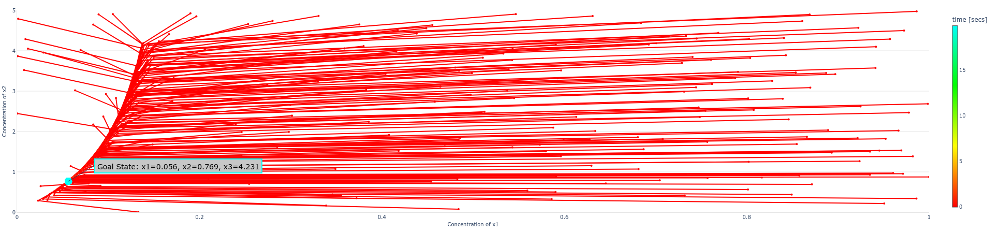

In [13]:
# Plot discoveries
fig = go.Figure(layout=default_layout)

for i in range(N):
    # downsample traj for display
    trajectory, display_ts = downsample_traj(trajectories[i], scaling_vector, 1e-3)
    marker=Dict(color=ts[display_ts], colorscale=traj_cscale, size=4)
    if i==N-1:
        marker.colorbar=Dict(title="time [secs]", thickness=10)
    fig.add_trace(go.Scatter(x=trajectory[0], y=trajectory[2], line=Dict(color=traj_cscale[0][1]), mode="lines+markers", 
                             marker=marker, hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_trace(go.Scatter(x=trajectories[:, 0, -1], y=trajectories[:, 1, -1], mode="markers", marker=Dict(color=traj_cscale[-1][1], size=14), 
                         hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_annotation(x=attractor[y_indexes['x1']], y=attractor[y_indexes['x2']], ax=50, xanchor="left", font=Dict(size=14, color="black"),
                   text=f"Goal State: x1={attractor[y_indexes['x1']]:.3f}, x2={attractor[y_indexes['x2']]:.3f}, x3={attractor[y_indexes['x3']]:.3f}",
                   bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7",)
fig.update_xaxes(title_text="Concentration of x1", range=[0, 1])
fig.update_yaxes(title_text="Concentration of x2", range=[0, 5])
fig.show()

if nb_save_figs:
    fig.write_json(f"figures/sanitycheck_fig_1.json")

#### IMGEP Exploration

In [14]:
# Create Experiment Config
experiment_config_v1 = ExperimentConfig("model_454_v1", "model_454_v1.py", [y_indexes["x1"], y_indexes["x3"]], ymin, ymax, T, 3)

# Run IMGEP Experiment
random_intervention_generator_v1, intervention_fn_v1, gc_intervention_optimizer_v1 = create_custom_intervention_modules_model_454_v1(model, y0) ## custom intervention modules to respect x2+x3 = 5 at t=0
run_experiment(experiment_config_v1, random_intervention_generator_v1, intervention_fn_v1, gc_intervention_optimizer_v1)

Generate random intervention
Generate the perturbation
Rollout the system
Encode the reached goal
Compute the distance to target goal
Encode the rollout statistics
Append to history
Generate random intervention
Generate the perturbation
Rollout the system
Encode the reached goal
Compute the distance to target goal
Encode the rollout statistics
Append to history
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate ta

In [15]:
# Load the discoveries of the IMGEP
history = DictTree.load(experiment_config_v1.get_pipeline_config().experiment_data_save_folder+"history.pickle")
ys_v1_imgep = history.system_output_library.ys

# Prepare downsampling of traj for plotting
attractor = ys_v1_imgep[0,:,-1]
trajectories = jnp.array(ys_v1_imgep[:, jnp.array([y_indexes["x1"], y_indexes["x2"]]), :])
scaling_vector = jnp.nanmax(trajectories, (0,2)) - jnp.nanmin(trajectories, (0,2))

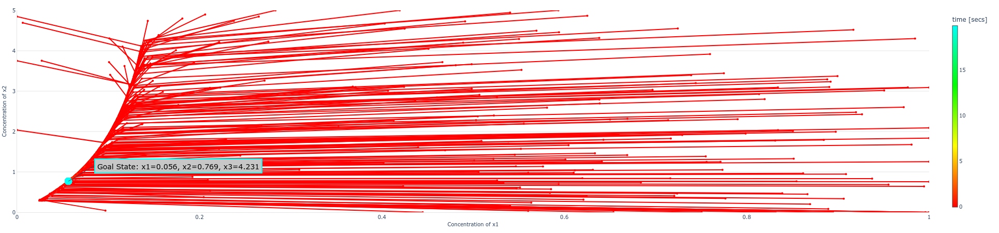

In [16]:
# Plot discoveries
fig = go.Figure(layout=default_layout)

for i in range(N):
    # downsample traj for display
    trajectory, display_ts = downsample_traj(trajectories[i], scaling_vector, 1e-3)
    marker=Dict(color=ts[display_ts], colorscale=traj_cscale, size=4)
    if i==N-1:
        marker.colorbar=Dict(title="time [secs]", thickness=10)
    fig.add_trace(go.Scatter(x=trajectory[0], y=trajectory[2], line=Dict(color=traj_cscale[0][1]), mode="lines+markers", 
                             marker=marker, hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_trace(go.Scatter(x=trajectories[:, 0, -1], y=trajectories[:, 1, -1], mode="markers", marker=Dict(color=traj_cscale[-1][1], size=14), 
                         hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_annotation(x=attractor[y_indexes['x1']], y=attractor[y_indexes['x2']], ax=50, xanchor="left", font=Dict(size=14, color="black"),
                   text=f"Goal State: x1={attractor[y_indexes['x1']]:.3f}, x2={attractor[y_indexes['x2']]:.3f}, x3={attractor[y_indexes['x3']]:.3f}",
                   bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7",)
fig.update_xaxes(title_text="Concentration of x1", range=[0, 1])
fig.update_yaxes(title_text="Concentration of x2", range=[0, 5])
fig.show()

if nb_save_figs:
    fig.write_json(f"figures/sanitycheck_fig_2.json")

### Case 2: Relaxing the moiety-conserved concentration to $x_2+x3=c, c \in \mathbb{R}_+$

#### Random Exploration

In [17]:
# Sample N random initial conditions
batched_y0 = jnp.zeros((N, len(y0)))
key, subkey = jrandom.split(key)
batched_y0 = jrandom.uniform(subkey, minval=ymin, maxval=ymax, shape=(N, len(y0)))

# Simulate model in batch mode
n_steps = int(T / model.deltaT)
ys_v2_rs, _, _ = batched_model(n_steps, batched_y0)

In [18]:
# Prepare downsampling of traj for plotting
attractor = ys_v2_rs[0,:,-1]
trajectories = jnp.array(ys_v2_rs[:, jnp.array([y_indexes["x1"], y_indexes["x2"]]), :])
scaling_vector = jnp.nanmax(trajectories, (0,2)) - jnp.nanmin(trajectories, (0,2))

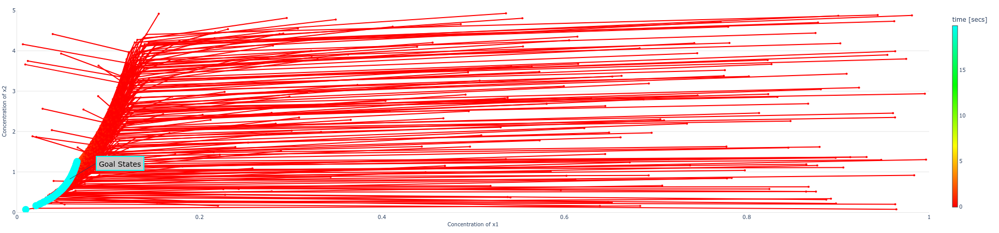

In [19]:
# Plot discoveries
fig = go.Figure(layout=default_layout)

for i in range(N):
    # downsample traj for display
    trajectory, display_ts = downsample_traj(trajectories[i], scaling_vector, 1e-3)
    marker=Dict(color=ts[display_ts], colorscale=traj_cscale, size=4)
    if i==N-1:
        marker.colorbar=Dict(title="time [secs]", thickness=10)
    fig.add_trace(go.Scatter(x=trajectory[0], y=trajectory[2], line=Dict(color=traj_cscale[0][1]), mode="lines+markers", 
                             marker=marker, hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_trace(go.Scatter(x=trajectories[:, 0, -1], y=trajectories[:, 1, -1], mode="markers", marker=Dict(color=traj_cscale[-1][1], size=14), 
                         hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_annotation(x=attractor[y_indexes['x1']], y=attractor[y_indexes['x2']], ax=50, xanchor="left", font=Dict(size=14, color="black"),
                   text=f"Goal States",
                   bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7",)
fig.update_xaxes(title_text="Concentration of x1", range=[0, 1])
fig.update_yaxes(title_text="Concentration of x2", range=[0, 5])
fig.show()

if nb_save_figs:
    fig.write_json(f"figures/sanitycheck_fig_3.json")

#### IMGEP Exploration

In [20]:
# Create Experiment Config
experiment_config_v2 = ExperimentConfig("model_454_v2", "model_454_v1.py", [y_indexes["x1"], y_indexes["x3"]], ymin, ymax, T, 3)


# Run IMGEP Experiment
run_experiment(experiment_config_v2)

Generate random intervention
Generate the perturbation
Rollout the system
Encode the reached goal
Compute the distance to target goal
Encode the rollout statistics
Append to history
Generate random intervention
Generate the perturbation
Rollout the system
Encode the reached goal
Compute the distance to target goal
Encode the rollout statistics
Append to history
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate ta

In [21]:
# Load the discoveries of the IMGEP
history = DictTree.load(experiment_config_v2.get_pipeline_config().experiment_data_save_folder+"history.pickle")
ys_v2_imgep = history.system_output_library.ys

# Prepare downsampling of traj for plotting
attractor = ys_v2_imgep[0,:,-1]
trajectories = jnp.array(ys_v2_imgep[:, jnp.array([y_indexes["x1"], y_indexes["x2"]]), :])
scaling_vector = jnp.nanmax(trajectories, (0,2)) - jnp.nanmin(trajectories, (0,2))

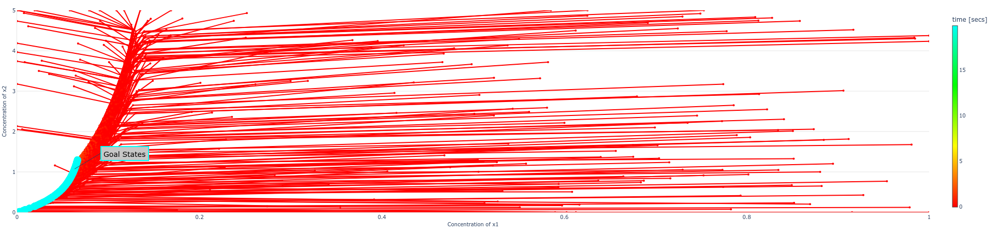

In [22]:
# Plot discoveries
fig = go.Figure(layout=default_layout)

for i in range(N):
    # downsample traj for display
    trajectory, display_ts = downsample_traj(trajectories[i], scaling_vector, 1e-3)
    marker=Dict(color=ts[display_ts], colorscale=traj_cscale, size=4)
    if i==N-1:
        marker.colorbar=Dict(title="time [secs]", thickness=10)
    fig.add_trace(go.Scatter(x=trajectory[0], y=trajectory[2], line=Dict(color=traj_cscale[0][1]), mode="lines+markers", 
                             marker=marker, hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_trace(go.Scatter(x=trajectories[:, 0, -1], y=trajectories[:, 1, -1], mode="markers", marker=Dict(color=traj_cscale[-1][1], size=14), 
                         hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_annotation(x=attractor[y_indexes['x1']], y=attractor[y_indexes['x2']], ax=50, xanchor="left", font=Dict(size=14, color="black"),
                   text=f"Goal States",
                   bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7",)
fig.update_xaxes(title_text="Concentration of x1", range=[0, 1])
fig.update_yaxes(title_text="Concentration of x2", range=[0, 5])
fig.show()

if nb_save_figs:
    fig.write_json(f"figures/sanitycheck_fig_4.json")

### Case 3: Relaxing metabolic concentrations to variables $(y_1(t), \dots, y_5(t)) \in \mathbb{R}_+^5$

In [23]:
# load model
model, y0, w0, c = load_biomodel(454, model_fp="data/model_454_v2.py", vary_constant_reactants=True, vary_boundary_reactants=True)
batched_model = vmap(model, in_axes=(None, 0), out_axes=(0, 0, None))
y_indexes = model.modelstepfunc.y_indexes
ymin = jnp.zeros((8,))
ymax = jnp.array([100., 5., 1., 5., 10., 10., 10., 10.])

#### Random Exploration

In [24]:
# Sample N random initial conditions
key, subkey = jrandom.split(key)
batched_y0 = jrandom.uniform(subkey, minval=ymin, maxval=ymax, shape=(N, len(y0)))

# Simulate model in batch mode
n_steps = int(T / model.deltaT)
ys_v3_rs, _, _ = batched_model(n_steps, batched_y0)

In [25]:
# Prepare downsampling of traj for plotting
attractor = ys_v3_rs[0,:,-1]
trajectories = jnp.array(ys_v3_rs[:, jnp.array([y_indexes["x1"], y_indexes["x2"]]), :])
scaling_vector = jnp.nanmax(trajectories, (0,2)) - jnp.nanmin(trajectories, (0,2))

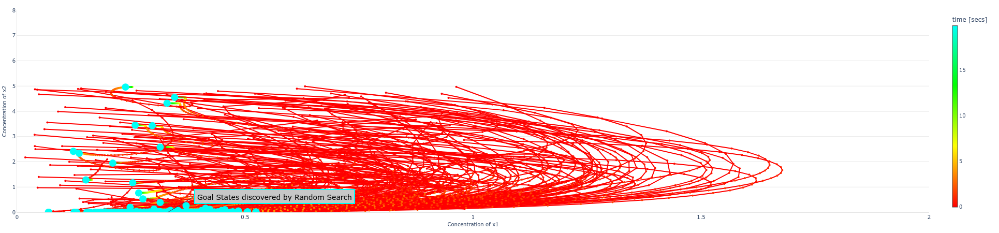

In [26]:
# Plot discoveries
fig = go.Figure(layout=default_layout)

for i in range(N):
    # downsample traj for display
    trajectory, display_ts = downsample_traj(trajectories[i], scaling_vector, 1e-3)
    marker=Dict(color=ts[display_ts], colorscale=traj_cscale, size=4)
    if i==N-1:
        marker.colorbar=Dict(title="time [secs]", thickness=10)
    fig.add_trace(go.Scatter(x=trajectory[0], y=trajectory[2], line=Dict(color=traj_cscale[0][1]), mode="lines+markers", 
                             marker=marker, hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_trace(go.Scatter(x=trajectories[:, 0, -1], y=trajectories[:, 1, -1], mode="markers", marker=Dict(color=traj_cscale[-1][1], size=14), 
                         hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_annotation(x=attractor[y_indexes['x1']], y=attractor[y_indexes['x2']], ax=50, xanchor="left", font=Dict(size=14, color="black"),
                   text=f"Goal States discovered by Random Search",
                   bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7",)
fig.update_xaxes(title_text="Concentration of x1", range=[0, 2])
fig.update_yaxes(title_text="Concentration of x2", range=[0, 8])
fig.show()

if nb_save_figs:
    fig.write_json(f"figures/sanitycheck_fig_5.json")

#### IMGEP Exploration

In [27]:
# Create Experiment Config
experiment_config_v3 = ExperimentConfig("model_454_v3", "model_454_v2.py", [y_indexes["x1"], y_indexes["x2"]], ymin, ymax, T, 8)


# Run IMGEP Experiment
run_experiment(experiment_config_v3)

Generate random intervention
Generate the perturbation
Rollout the system
Encode the reached goal
Compute the distance to target goal
Encode the rollout statistics
Append to history
Generate random intervention
Generate the perturbation
Rollout the system
Encode the reached goal
Compute the distance to target goal
Encode the rollout statistics
Append to history
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate ta

In [28]:
# Load the discoveries of the IMGEP
history = DictTree.load(experiment_config_v3.get_pipeline_config().experiment_data_save_folder+"history.pickle")
ys_v3_imgep = history.system_output_library.ys

# Prepare downsampling of traj for plotting
attractor = ys_v3_imgep[0,:,-1]
trajectories = jnp.array(ys_v3_imgep[:, jnp.array([y_indexes["x1"], y_indexes["x2"]]), :])
scaling_vector = jnp.nanmax(trajectories, (0,2)) - jnp.nanmin(trajectories, (0,2))

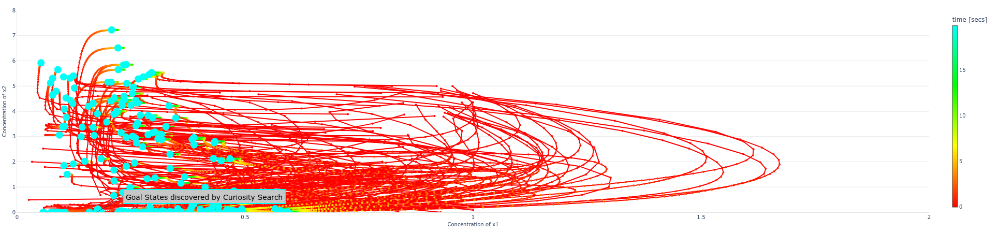

In [29]:
# Plot discoveries
fig = go.Figure(layout=default_layout)

for i in range(N):
    # downsample traj for display
    trajectory, display_ts = downsample_traj(trajectories[i], scaling_vector, 1e-3)
    marker=Dict(color=ts[display_ts], colorscale=traj_cscale, size=4)
    if i==N-1:
        marker.colorbar=Dict(title="time [secs]", thickness=10)
    fig.add_trace(go.Scatter(x=trajectory[0], y=trajectory[2], line=Dict(color=traj_cscale[0][1]), mode="lines+markers", 
                             marker=marker, hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_trace(go.Scatter(x=trajectories[:, 0, -1], y=trajectories[:, 1, -1], mode="markers", marker=Dict(color=traj_cscale[-1][1], size=14), 
                         hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_annotation(x=attractor[y_indexes['x1']], y=attractor[y_indexes['x2']], ax=50, xanchor="left", font=Dict(size=14, color="black"),
                   text=f"Goal States discovered by Curiosity Search",
                   bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7",)
fig.update_xaxes(title_text="Concentration of x1", range=[0, 2])
fig.update_yaxes(title_text="Concentration of x2", range=[0, 8])
fig.show()

if nb_save_figs:
    fig.write_json(f"figures/sanitycheck_fig_6.json")

## Sanity Check 2: BIOMD0000000341

In [30]:
# load model
model, y0, w0, c = load_biomodel(341, model_fp="data/model_341.py")
batched_model = vmap(model, in_axes=(None, 0), out_axes=(0, 0, None))
y_indexes = model.modelstepfunc.y_indexes


# Hyper-parameter
T = 1000 # need longer time to converge
N = 100 # we do only 100 explorations
r = 5
ymin = y0/r
ymax = y0*r

### Random Exploration

In [31]:
# Sample N random initial conditions
batched_y0 = jnp.zeros((N, len(y0)))
key, subkey = jrandom.split(key)
batched_y0 = jrandom.uniform(subkey, minval=ymin, maxval=ymax, shape=(N, len(y0)))

# Simulate model in batch mode
n_steps = int(T / model.deltaT)
ys_rs, _, ts = batched_model(n_steps, batched_y0)

In [32]:
# Prepare downsampling of traj for plotting
attractor = ys_rs[0,:,-1]
trajectories = jnp.array(ys_rs[:, jnp.array([y_indexes["B"], y_indexes["G"]]), :])
scaling_vector = jnp.nanmax(trajectories, (0,2)) - jnp.nanmin(trajectories, (0,2))

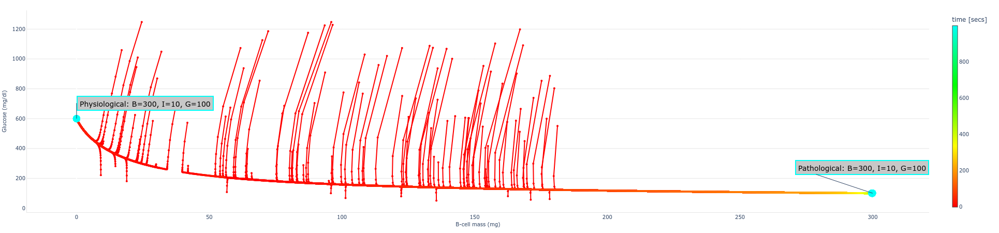

In [33]:
# Plot discoveries
fig = go.Figure(layout=default_layout)

for i in range(N):
    # downsample traj for display
    trajectory, display_ts = downsample_traj(trajectories[i], scaling_vector, 1e-3)
    marker=Dict(color=ts[display_ts], colorscale=traj_cscale, size=4)
    if i==N-1:
        marker.colorbar=Dict(title="time [secs]", thickness=10)
    fig.add_trace(go.Scatter(x=trajectory[0], y=trajectory[2], line=Dict(color=traj_cscale[0][1]), mode="lines+markers", 
                             marker=marker, hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_trace(go.Scatter(x=trajectories[:, 0, -1], y=trajectories[:, 1, -1], mode="markers", marker=Dict(color=traj_cscale[-1][1], size=14), 
                         hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_annotation(x=300, y=100, ax=-150, ay=-50, xanchor="left", font=Dict(size=14, color="black"), text=f"Pathological: B=300, I=10, G=100", bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7")
fig.add_annotation(x=0, y=600, ax=0, xanchor="left", font=Dict(size=14, color="black"), text=f"Physiological: B=300, I=10, G=100", bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7")
fig.update_xaxes(title_text="B-cell mass (mg)")
fig.update_yaxes(title_text="Glucose (mg/dl)")
fig.show()

if nb_save_figs:
    fig.write_json(f"figures/sanitycheck_fig_7.json")

### IMGEP Exploration

In [34]:
# Create Experiment Config
experiment_config = ExperimentConfig("model_341", "model_341.py", [y_indexes["B"], y_indexes["G"]], ymin, ymax, T, 3)


# Run IMGEP Experiment
run_experiment(experiment_config)

Generate random intervention
Generate the perturbation
Rollout the system
Encode the reached goal
Compute the distance to target goal
Encode the rollout statistics
Append to history
Generate random intervention
Generate the perturbation
Rollout the system
Encode the reached goal
Compute the distance to target goal
Encode the rollout statistics
Append to history
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate target goals
Select closes intervention
Optimize the selected intervention
Extract workers data from optimizer logs
Generate ta

In [35]:
# Load the discoveries of the IMGEP
history = DictTree.load(experiment_config.get_pipeline_config().experiment_data_save_folder+"history.pickle")
ys_imgep = history.system_output_library.ys

# Prepare downsampling of traj for plotting
attractor = ys_imgep[0,:,-1]
trajectories = jnp.array(ys_imgep[:, jnp.array([y_indexes["B"], y_indexes["G"]]), :])
scaling_vector = jnp.nanmax(trajectories, (0,2)) - jnp.nanmin(trajectories, (0,2))

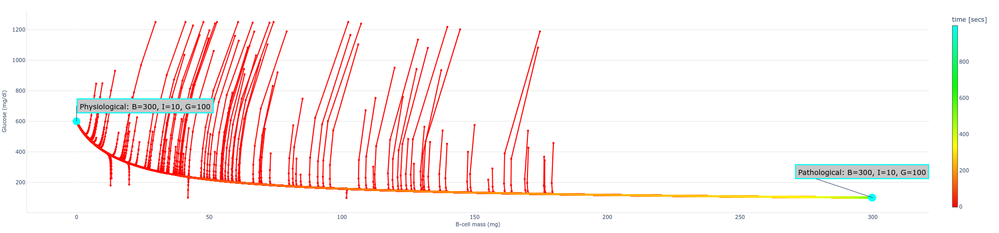

In [36]:
# Plot discoveries
fig = go.Figure(layout=default_layout)

for i in range(N):
    # downsample traj for display
    trajectory, display_ts = downsample_traj(trajectories[i], scaling_vector, 1e-3)
    marker=Dict(color=ts[display_ts], colorscale=traj_cscale, size=4)
    if i==N-1:
        marker.colorbar=Dict(title="time [secs]", thickness=10)
    fig.add_trace(go.Scatter(x=trajectory[0], y=trajectory[2], line=Dict(color=traj_cscale[0][1]), mode="lines+markers", 
                             marker=marker, hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_trace(go.Scatter(x=trajectories[:, 0, -1], y=trajectories[:, 1, -1], mode="markers", marker=Dict(color=traj_cscale[-1][1], size=14), 
                         hovertemplate = '(%{x:.02f}, %{y:.02f})<extra></extra>', showlegend=False))
fig.add_annotation(x=300, y=100, ax=-150, ay=-50, xanchor="left", font=Dict(size=14, color="black"), text=f"Pathological: B=300, I=10, G=100", bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7")
fig.add_annotation(x=0, y=600, ax=0, xanchor="left", font=Dict(size=14, color="black"), text=f"Physiological: B=300, I=10, G=100", bordercolor=traj_cscale[-1][1], borderwidth=2, borderpad=4, bgcolor="#c7c7c7")
fig.update_xaxes(title_text="B-cell mass (mg)")
fig.update_yaxes(title_text="Glucose (mg/dl)")
fig.show()

if nb_save_figs:
    fig.write_json(f"figures/sanitycheck_fig_8.json")